In [1]:
import os
import numpy as np
import pandas as pd
from model import compile_model,model_save 
import matplotlib.pylab as plt
from keras.utils import np_utils
from time import gmtime, strftime
from util import makedirs, ensure_dir
from prediction_phase import load_new_candidate, realbogus_prediction,load_prediction_candidate

#plt.rc('text', usetex=True)
#plt.rc('font',**{'family':'DejaVu Sans','serif':['Palatino']})
figSize  = (12, 8)
fontSize = 20
%matplotlib inline


Using TensorFlow backend.
/home/hosenie/.conda/envs/meercrab/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:523: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/hosenie/.conda/envs/meercrab/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:524: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/hosenie/.conda/envs/meercrab/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:525: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/hosenie/.conda

In [2]:
# data_with_prob =  pd.read_csv('../data/threshold_9_prob0-5_image_data_without_label.csv')
data_with_prob =  pd.read_csv('../data/label_9_confused_image_data_with_label_and_prob.csv')
print(data_with_prob.shape)
data_with_prob.head()

(623, 7)


,transientid,image_scorr,image_difference,image_ref,real_image,HUMAN_PROB_REAL,label
0,5408,3c0628406fd6104075a40740ac990a40fefdeb3fd3c584...,45a34b42010070415691f441939e8ac10b6a5fc11e8d6e...,b0c81cc200b00340004885c0609a85c140632341007553...,40293c42189098c2e0e6eec1603bd241a0dfbd4100542e...,0.7,1
1,5490,9040bc3f2265553fa3dd873eb57269bc3cd8923c65b903...,5f9e63c208c95fc26a0af041b77cacc20fa1a24135f593...,007ec1bf205eeac100d006bf8053e74040fc08c200a27a...,8033a641003f04c2801fa340d0a203c2004960400047fc...,0.7,1
2,6930,24b003c0f84320c03c4922c096fa17c0ad050bc0eba7f8...,30fe8dc2d70b8dc243553d418b8b1bc2d27c9bc0e3846e...,b0d90e420011244180c0ab41005a44c100b02b41205c48...,e064dbc1802e9a40a000c9c1b02b07c2f00a094200ff2e...,0.8,1
3,7132,5cab58bf4f40dbbe29e0b2bd2064a2bde63be4bef8135c...,a0821ac211d10fc2c2cf1d4233603b42a4f80542970285...,00dcabbfb00b12c2c0cb42410034c7c0405ce2c1404b2b...,60e8b9c1b04f884270863d42a0499641c09d5fc100992a...,0.7,1
4,7296,b536efbf75960ac0835305c069ffd3bfb9108fbfc9260a...,6203a64185ac97c1c329ccc18c531c42a0508f404cb7c0...,40bc84c10034eb414049734160d9f5c160d4ca41304587...,b05c0dc2806b384100de903fc06a58c20078bfbfc08e06...,0.8,1


In [3]:
data = data_with_prob.drop(columns=['HUMAN_PROB_REAL'])
data.shape

(623, 6)

In [4]:
# Parameters to change
nClasses   = 2  # The number of classes we are classifying: Real and Bogus
minPix     = 35 # The minimum pixel to be used from the image : 0, 25, 35
maxPix     = 65 # The maximum pixel to be used from the image: 100, 75, 65
num_images = 'NRD'  # The number of images to used for testing either 4, 3, 2
threshold = 'threshold_9'
model_cnn_name = 'NET3' # The network name choose from: 'NET1_32_64','NET1_64_128','NET1_128_256','NET2','NET3'


# Load the new candidates
- ID: The first column of the csv file is 'transientid' --> data.iloc[:,0]
- full_data : Here we will provide the whole csv file as above, the code will atomatically select the last 4 or 3 column to extract the images. Four last columns is the candidate file in the order of (20)New Image, (21)Ref Image, (22)Diff Image, (23)Scorr image

- n_images: The number of images to consider 4, 3, 2. Note that here we should be carefull. If             the network that we will select below has been trained on 3 images, therefore we               will need to use n_images=3
- min_pix: value range from 0 to 100 (applied when cropped = True). Note that here we should be carefull. If the network that we will select below has been trained on 30X30 images, therefore we will need to use min_pix=35.
- max_pix: value range from 0 to 100 (applied when cropped = True). Note that here we should be carefull. If the network that we will select below has been trained on 30X30 images, therefore we will need to use max_pix=65.
- cropped: True - cropping is done from the centre. If we want 30X30 pixels image, then min_pix= 35, max_pix=65

In [5]:
test, ID_test = load_prediction_candidate(ID=data.iloc[:,0].values,full_data=data,n_images=num_images,minPix=minPix,maxPix=maxPix,cropped=True)
print("Total number of training instances: {}".format(str(len(ID_test))))
print("The Shape of the test set is {}".format(test.shape))

Total number of training instances: 623
The Shape of the test set is (623, 30, 30, 3)


In [6]:
overall_real_prob, overall_dataframe = realbogus_prediction(model_name=model_cnn_name+'_'+threshold+'_'+num_images, \
                                                            X_test=test,ID=ID_test, probability_threshold=0.5,\
                                                           model_path='../meerCRAB_model/')


Loaded model:NET3_threshold_9_NRD from disk


In [7]:
overall_dataframe

,transientid,ML_PROB_REAL,label
0,5408,0.999873,1.0
1,5490,0.004469,0.0
2,6930,0.999995,1.0
3,7132,1.000000,1.0
4,7296,1.000000,1.0
...,...,...,...
618,2997022,1.000000,1.0
619,3000742,1.000000,1.0
620,3002428,1.000000,1.0
621,3003014,1.000000,1.0


In [8]:
data_final = pd.merge(data_with_prob,overall_dataframe, on='transientid')
print(data_final.shape)
data_final.head()

(623, 9)


,transientid,image_scorr,image_difference,image_ref,real_image,HUMAN_PROB_REAL,label_x,ML_PROB_REAL,label_y
0,5408,3c0628406fd6104075a40740ac990a40fefdeb3fd3c584...,45a34b42010070415691f441939e8ac10b6a5fc11e8d6e...,b0c81cc200b00340004885c0609a85c140632341007553...,40293c42189098c2e0e6eec1603bd241a0dfbd4100542e...,0.7,1,0.999873,1.0
1,5490,9040bc3f2265553fa3dd873eb57269bc3cd8923c65b903...,5f9e63c208c95fc26a0af041b77cacc20fa1a24135f593...,007ec1bf205eeac100d006bf8053e74040fc08c200a27a...,8033a641003f04c2801fa340d0a203c2004960400047fc...,0.7,1,0.004469,0.0
2,6930,24b003c0f84320c03c4922c096fa17c0ad050bc0eba7f8...,30fe8dc2d70b8dc243553d418b8b1bc2d27c9bc0e3846e...,b0d90e420011244180c0ab41005a44c100b02b41205c48...,e064dbc1802e9a40a000c9c1b02b07c2f00a094200ff2e...,0.8,1,0.999995,1.0
3,7132,5cab58bf4f40dbbe29e0b2bd2064a2bde63be4bef8135c...,a0821ac211d10fc2c2cf1d4233603b42a4f80542970285...,00dcabbfb00b12c2c0cb42410034c7c0405ce2c1404b2b...,60e8b9c1b04f884270863d42a0499641c09d5fc100992a...,0.7,1,1.000000,1.0
4,7296,b536efbf75960ac0835305c069ffd3bfb9108fbfc9260a...,6203a64185ac97c1c329ccc18c531c42a0508f404cb7c0...,40bc84c10034eb414049734160d9f5c160d4ca41304587...,b05c0dc2806b384100de903fc06a58c20078bfbfc08e06...,0.8,1,1.000000,1.0


## Probability Distribution of Vetters and ML

Substituting symbol P from STIXNonUnicode
Substituting symbol P from STIXNonUnicode
Substituting symbol P from STIXNonUnicode
Substituting symbol P from STIXNonUnicode


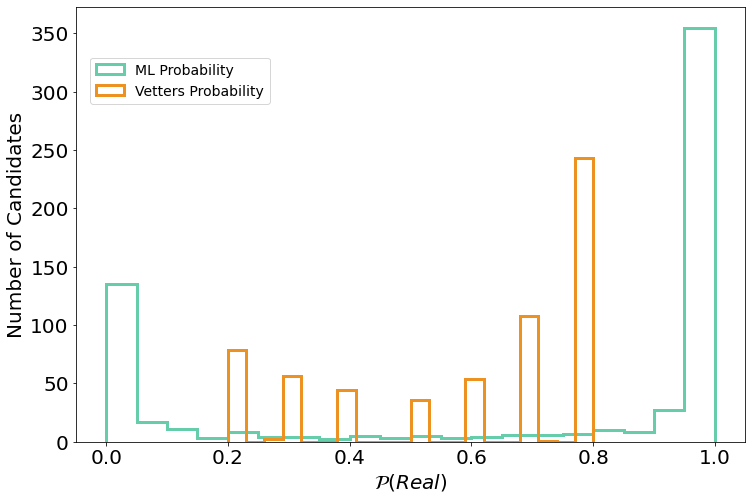

In [9]:
plt.figure(figsize=figSize)
plt.hist(data_final['ML_PROB_REAL'],color='#66CDAA',bins=20, label='ML Probability',histtype='step',lw=3)
plt.hist(data_final['HUMAN_PROB_REAL'],color='#ED9121',bins=20,label='Vetters Probability',histtype='step',lw=3)
plt.xlabel("$\mathcal{P}(Real)$",fontsize=fontSize)
plt.ylabel("Number of Candidates",fontsize=fontSize)
plt.tick_params(axis='both', labelsize=fontSize)
plt.legend(loc="best",prop={'size':14},bbox_to_anchor=(0.3,0.8994))
odir = '../meerCRAB_output/plots/threshold_8/'
ensure_dir(odir)
plt.savefig(odir+'real_probability_output.pdf', bbox_inches='tight', pad_inches=0.1)
plt.show()

/home/hosenie/.conda/envs/meercrab/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


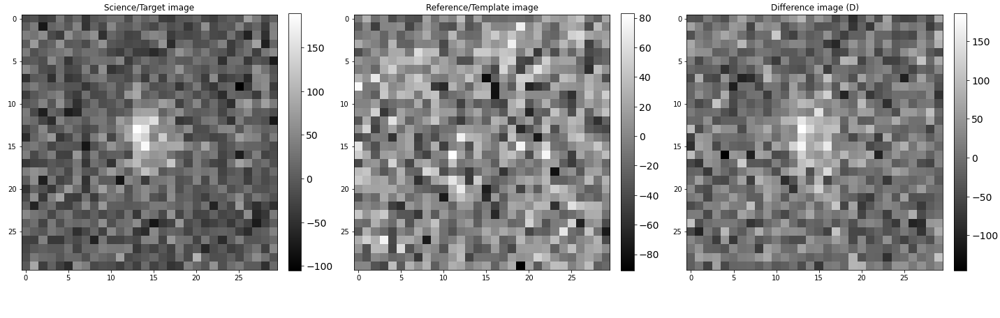

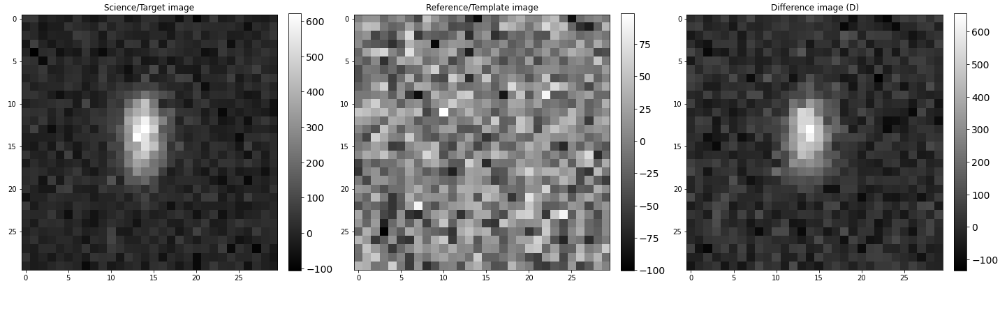

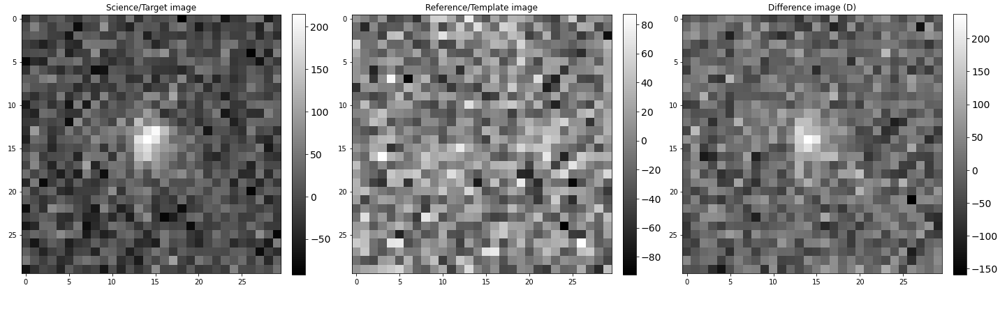

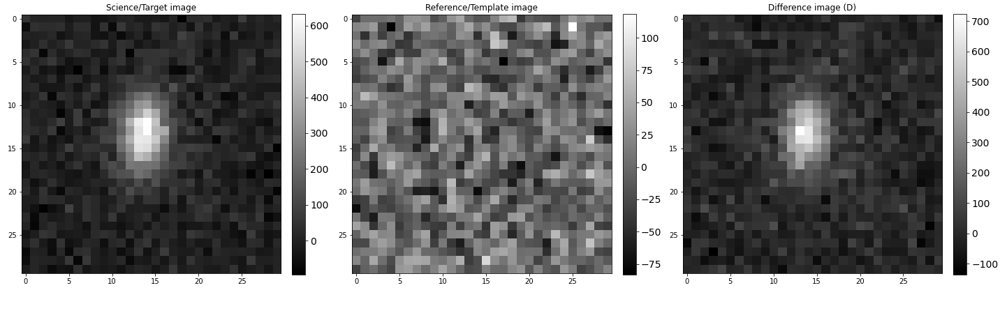

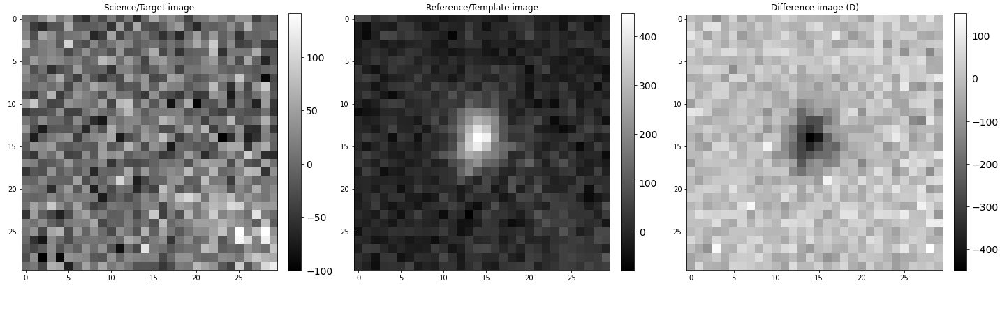

...

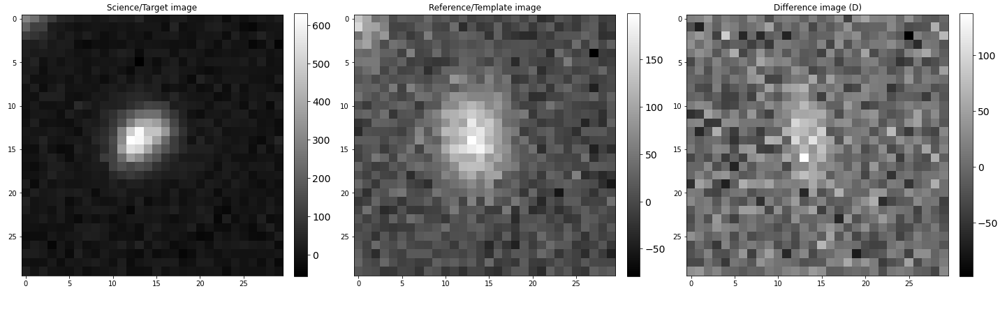

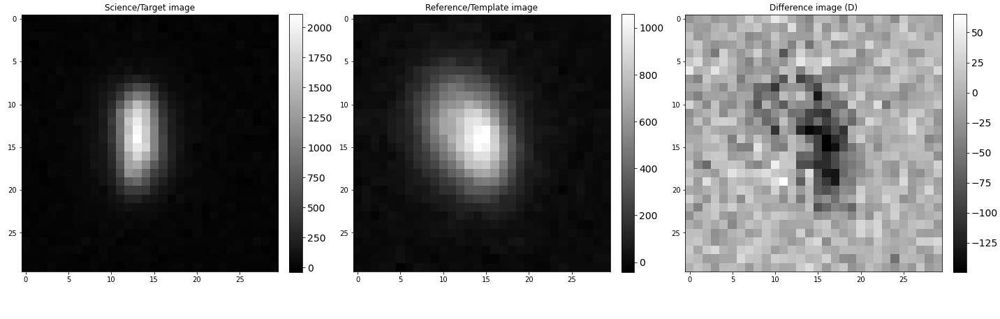

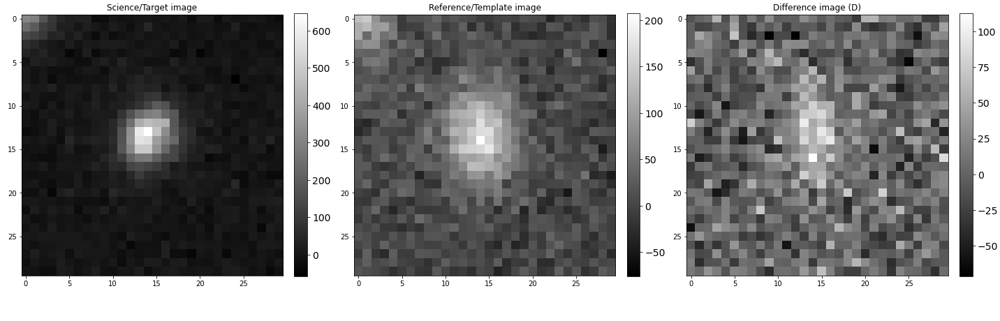

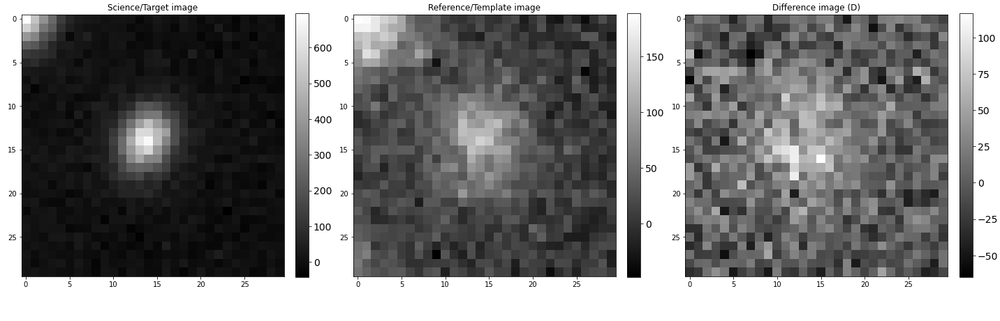

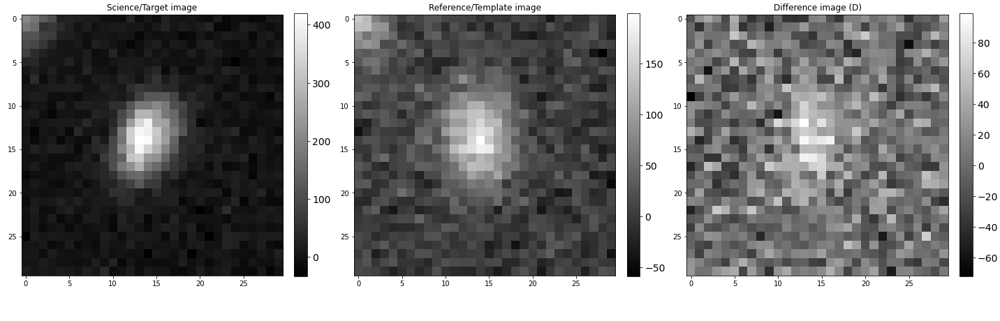

In [10]:
data = test*255.
for j in range(data.shape[0]):#3):
    fig, axs = plt.subplots(1,data.shape[3], figsize=(20, 7), facecolor='w', edgecolor='k')
    fig.subplots_adjust(hspace = .5, wspace=.15)
    titles = ['Science/Target image','Reference/Template image', 'Difference image (D)','Significance image (Scorr)']    
    axs    = axs.ravel()
    human_prob = data_final[data_final.transientid==ID_test[j]].HUMAN_PROB_REAL.values
    ml_prob = data_final[data_final.transientid==ID_test[j]].ML_PROB_REAL.values

    if (ml_prob[0]>0.5):
        label = 1
    else:
        label = 0

    for i in range(1,data.shape[3]+1):
        varray = data[j,:,:,i-1]
        im     = axs[i-1].imshow(varray[:,:],cmap='gray')
        cb     = fig.colorbar(im,fraction=0.046, pad=0.04,ax=axs[i-1])
        cb.ax.tick_params(labelsize=14)
        axs[i-1].title.set_text(titles[i-1])
    plt.tight_layout() 

    fig.suptitle('ID {}, Vetters Prob = {}, ML prob real = {:.2f}, ML label = {}'.format(int(ID_test[j]), human_prob[0], ml_prob[0], label))
    odir = '../meerCRAB_output/plots/threshold_9/confused_cadidates/'
    ensure_dir(odir)
    plt.savefig(odir+str(ID_test[j]) + ".pdf", bbox_inches='tight', pad_inches=0.1)
plt.show()

